In [1]:
from mesh_utils import *
from plotting_utils import *

## Extract mesh from the off file

In [2]:
vertices, triangles = read_off("../../data/meshes/moomoo_s0.off")

## Define the space

In [18]:
N = 100
t = np.linspace(0, 1, N)
space = np.stack(np.meshgrid(t, t, t), axis=-1).reshape(N**3, -1)

x = space[:, 0]
y = space[:, 1]
z = space[:, 2]

In [19]:
from toolbox.rescale import rescale
vertices = rescale(vertices, 0, 1)

## Get the shape as a distribution

In [20]:
def vectorized_is_point_inside_mesh(points, vertices, triangles):
    def ray_intersects_triangle(ray_origin, ray_direction, triangle_vertices):
        v0, v1, v2 = triangle_vertices
        e1 = v1 - v0
        e2 = v2 - v0
        h = np.cross(ray_direction, e2)
        a = np.dot(e1, h)

        mask_a = (a > -1e-6) & (a < 1e-6)
        f = np.where(mask_a, np.inf, 1.0 / a)

        s = ray_origin - v0
        u = f * np.dot(s, h)

        mask_u = (u < 0.0) | (u > 1.0)
        f = np.where(mask_u, np.inf, f)

        q = np.cross(s, e1)
        v = f * np.dot(q, ray_direction)

        mask_v = (v < 0.0) | ((u + v) > 1.0)
        f = np.where(mask_v, np.inf, f)

        t = f * np.dot(q, e2)

        return (t > 1e-6) & (t != np.inf)   

    # Check if the points are inside the mesh volume
    ray_origin = points#[:, np.newaxis, :]
    ray_direction = np.array([1, 0, 0])  # Choose a ray direction (e.g., along the positive x-axis)

    inside_count = 0

    for triangle_indices in triangles:
        triangle_vertices = vertices[triangle_indices]
        intersections = ray_intersects_triangle(ray_origin, ray_direction, triangle_vertices)
        inside_count += intersections

    # If the number of intersections is odd, the points are inside the mesh volume
    return (inside_count % 2) == 1

In [21]:
points_inside = vectorized_is_point_inside_mesh(space, vertices, triangles)

/var/folders/95/8440dy8n015fkrp5pqq8v4r00000gn/T/ipykernel_28049/1086475535.py:21: RuntimeWarning:

invalid value encountered in add



In [40]:
points_inside.shape

(1000000,)

: 

In [23]:
x = space[points_inside][:, 0]
y = space[points_inside][:, 1]
z = space[points_inside][:, 2]

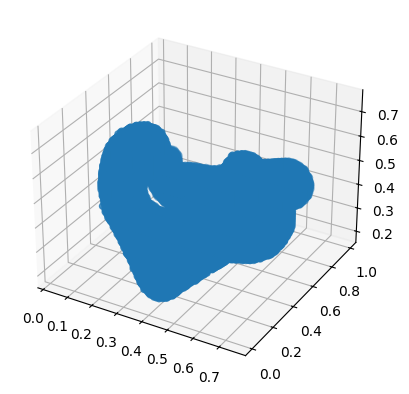

In [24]:
import matplotlib.pyplot as plt
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.scatter(x, y, z)

In [26]:
fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z,
                                   mode='markers')])
fig.show()

## Blur

In [31]:
def rescale(array, a, b):
    return (b - a) * (array - array.min()) / (array.max() - array.min()) + a

In [32]:
fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z,
                                   mode='markers',
                                   marker=dict(
                                    size=rescale(points_inside.reshape(N, N, N).astype(np.float32), 0, 1),
                                    #color=,                # set color to an array/list of desired values
                                    colorscale='Viridis',   # choose a colorscale
                                    opacity=0.5
                                ))])
fig.show()

In [38]:
from toolbox.blur_kernal import imgaussian
mu=N/40
im = imgaussian(points_inside.reshape(N, N, N).astype(np.float32), sigma=mu, siz=mu*50)
fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z,
                                   mode='markers',
                                   marker=dict(
                                    size=5,
                                    #color=,                # set color to an array/list of desired values
                                    colorscale='Viridis',   # choose a colorscale
                                    opacity=1
                                ))])
fig.show()

## Attempt to plot

In [37]:
import numpy as np
from mayavi import mlab

def plot_isosurface(M, options):
    mlab.clf()

    n = max(M.shape)
    t = np.linspace(-1, 1, n)
    
    space = np.stack(np.meshgrid(t, t, t), axis=-1)
    x = space[:, :, :, 0]
    y = space[:, :, :, 1]
    z = space[:, :, :, 2]

    isolevel = options.get('isolevel', (np.max(M) - np.min(M)) / 2)
    t = options.get('t', [])
    alpha_val = options.get('alpha', 1)
    color = options.get('color', (1, 0, 0))  # Default to red)
    F = mlab.contour3d(x, y, z, M, contours=[isolevel], color=color, transparent=True)
    
    # Setting properties
    F.actor.property.opacity = alpha_val

    mlab.view(azimuth=45, elevation=45)
    mlab.show()
    

options = {'isolevel': 0.5, 'alpha': 0.7, 'color': (1, 0, 0)}
plot_isosurface(rescale(im, 0, 1), options)

(100, 100, 100) (100, 100, 100)
